In [42]:
# Heading

# Exploratory data analysis (EDA)


## Dataset: Import and Export by India

The notebooks explores the use of __Pandas__,__Seaborn__,__Matplotlib__,__Statistics__ and will cover the techniques of __Exploratory Data Analysis(EDA)__ which includes __cleaning__, __munging__, __combining__, __reshaping__, __slicing__, __dicing__, and __transforming data__ for analysis purpose.

* __Exploratory Data Analysis__ <br/>
Understand the data by EDA and derive simple models with Pandas as baseline.
EDA ia a critical and first step in analyzing the data and we do this for below reasons :
    - Finding patterns in Data
    - Determining relationships in Data
    - Checking of assumptions
    - Preliminary selection of appropriate models
    - Detection of mistakes 


### 1. Problem Statement

#### Some Background Information

 -This is Import and export data available by principle commodity and country wise for 
3 years from Apr'2014 to Mar'2017.
- Ministry of Commerce and Industry, Govt of India has published these datasets in Open Govt Data Platform India portal under Govt. Open Data License - India.

- The objective of this data analysis is to better understand the imports and exports by India related with differnt countries and variety of products.
- The analysis can help business to understand their potential, target markets in import and export business.
- This analysis can help in demand forcasting depend upon countries, regions, products and goods and their values
- This analysis can help to understand Top countries by growth percentage, growth of export and import.


### Description of the Dataset






<table>
<thead>
    <style>
td {
  text-align: center;
}
</style>
<tr>
<th>Column Name</th>
<th>Description</th>
</tr>
</thead>
<tbody><tr>
<td>pc_code</td>
<td>Principal Commodity Code</td>
</tr>
<tr>
<td>pc</td>
<td>Principal Commodity Name</td>
</tr>
<tr>
<td>unit</td>
<td>measurement of quantity</td>
</tr>
<tr>
<td>country_code</td>
<td>Integer, country code</td>
</tr>
<tr>
<td>country_name</td>
<td>String, country name</td>
</tr>
<tr>
<td>quantity</td>
<td>quantify of export or import</td>
</tr>
<tr>
<td>value</td>
<td>monetary valeu of the quantity (in million USD)</td>

#### Importing packages         

In [1]:

import os
import numpy as np
import pandas as pd
import pandas_profiling
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
import statsmodels.api as sm

#setting options to displys maximum data
pd.set_option('display.max_rows',None)
pd.set_option('display.max_columns',None)

## 3. Data Profiling

### 3.1 Understanding the Carsale Dataset

In [5]:
# Importing data present in differnt batches

import glob
path = r'C:\Users\PKK\Desktop\EDA\Import and Export by India'
all_files = glob.glob(path + "/*.csv")
li = []
for filename in all_files:
    df = pd.read_csv(filename, index_col=None, header=0,na_values=['Na','NaN',np.nan])
    li.append(df)
data = pd.concat(li, axis=0, ignore_index=True)
data.head()

    

,pc_code,pc_description,unit,country_code,country_name,quantity,value,year
0,99,Other Commodities,NaN,599,Unspecified,NaN,371.280801,2014-2015
1,99,Other Commodities,NaN,1213,Kenya,NaN,18.251164,2014-2015
2,99,Other Commodities,NaN,1395,Tanzania Rep,NaN,21.844100,2014-2015
3,99,Other Commodities,NaN,1417,Uganda,NaN,8.034605,2014-2015
4,99,Other Commodities,NaN,2035,Benin,NaN,1.812666,2014-2015


### General Information about Dataset

In [6]:
#Getting Information about the data

#Below function can output the information about the data
def dataset_info(data):
    
    print('Shape of Dataset',data.shape,'\n')
    print('\n','Number of Rows',data.shape[0],'\n\n','Number of Columns: ',data.shape[1])
    print('\n','Feature Names : \n',data.columns.values,'\n')
    print('Information about Datatypes: ')
    print('\n',data.info(),'\n')
    print('Unique values per column: ','\n',data.nunique(),'\n')
    print('Any Missing Values in data?: ',data.isnull().values.any())
    
    return(data.profile_report(minimal=True))

#Calling the function    
dataset_info(data)
                                                                          

Shape of Dataset (91440, 8) 


 Number of Rows 91440 

 Number of Columns:  8

 Feature Names : 
 ['pc_code' 'pc_description' 'unit' 'country_code' 'country_name'
 'quantity' 'value' 'year'] 

Information about Datatypes: 
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 91440 entries, 0 to 91439
Data columns (total 8 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   pc_code         91440 non-null  object 
 1   pc_description  91440 non-null  object 
 2   unit            42920 non-null  object 
 3   country_code    91440 non-null  int64  
 4   country_name    91440 non-null  object 
 5   quantity        42917 non-null  float64
 6   value           91440 non-null  float64
 7   year            91440 non-null  object 
dtypes: float64(2), int64(1), object(5)
memory usage: 5.6+ MB

 None 

Unique values per column:  
 pc_code             169
pc_description      169
unit                  5
country_code        243
country_name        244

### Missing Data Analysis and Imputation

any missing data in dataset: True 
 
 columnwise missing data :
          total_missing_count  percentage_missing datatype
unit                    48520           53.062117   object
quantity                48523           53.065398  float64

 
 Total percentage of missing data : 13.265939413823272  % 


 total percentage of rows affected by missing data : 53.0653980752406 % 



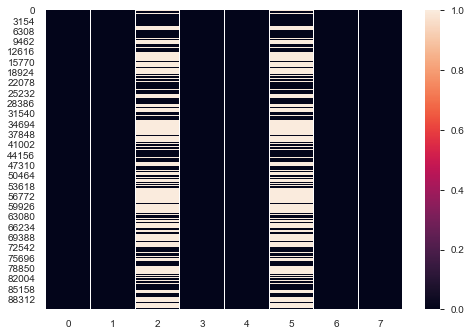

In [7]:
#Missing Data Analysis
def missing_data_analysis(data):
    print('any missing data in dataset:',data.isnull().values.any(),'\n','\n','columnwise missing data :')
    
    missing_data=pd.DataFrame({'total_missing_count':data.isnull().sum(),
                           'percentage_missing':data.isnull().sum()/data.shape[0]*100,
                           'datatype':data.dtypes
                          })

    
    print(missing_data[missing_data.total_missing_count>0])
    sns.heatmap(data.isnull().values)



    #Counting cells with missing values:(Total number of NA)
    a=sum(data.isnull().values.ravel())
    #Getting total number of cells
    b=np.prod(data.shape)
    #Getting percentage of NA in overall data
    print('\n','\n','Total percentage of missing data :',(a/b)*100,' % \n')


    #Calculating Rows affected by NA- Rows having na/ Total number of rows

    #Counting rows that have missing values somewhere:
    a=sum([True for idx,row in data.iterrows() if any(row.isnull())])
    #Total Number of rows in data
    b=data.shape[0]
    print('\n','total percentage of rows affected by missing data :',(a/b)*100,'% \n')

    
#calling the function
missing_data_analysis(data)

- We can see from the above missing data analysis that the unit and quantity columns has almost half of the values as missing.
- Missing data percentage in these columns is so high.
- We cannot impute these high quantity missing data. Doing this can change the distribution of the data. 
- We can treat the categorical missing data as the seperate category as 'not available'
- We can replace the numerical missing data by zero values
- From the above analysis we can see that removing 13% of missing data can affect the 53% of rows
- Hence we cannot delete the misisng data

Missing data imputed sucessfully


,pc_code,pc_description,unit,country_code,country_name,quantity,value,year
0,99,Other Commodities,not_available,599,Unspecified,0.0,371.280801,2014-2015
1,99,Other Commodities,not_available,1213,Kenya,0.0,18.251164,2014-2015
2,99,Other Commodities,not_available,1395,Tanzania Rep,0.0,21.844100,2014-2015
3,99,Other Commodities,not_available,1417,Uganda,0.0,8.034605,2014-2015
4,99,Other Commodities,not_available,2035,Benin,0.0,1.812666,2014-2015


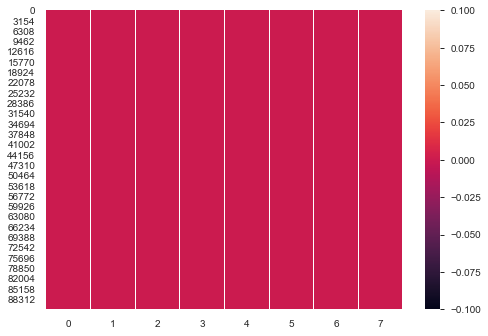

In [8]:
#As there is around 50% missing data in unit and quantity feature
#Filling the missing data accordingly
def missing_data_imputaion():
    data['unit'].fillna('not_available',inplace=True)
    data['quantity'].fillna(0,inplace=True)
    sns.heatmap(data.isnull().values)
    print('Missing data imputed sucessfully')
    return(data.head())

#calling the function
missing_data_imputaion()



- Missing data imputed sucessfully

### Removing Identifiers and Unnecessary Features

In [9]:
#Removing identifiers and unnecessary columns for better understanding and visulization of data
def identifiers_remove():
    data.drop(columns=['pc_code','country_code'],inplace=True)
identifiers_remove()

In [10]:

#Seperating numerical amd categorical columns for better analysis

numerical_data = data.select_dtypes('float64')
categorical_data = data.select_dtypes('object')
print('numeric and categorical data seperated sucessfully \n')
print('Numerical_Data: \n',numerical_data.head(),'\n')
print('Categorical_Data: \n',categorical_data.head())


numeric and categorical data seperated sucessfully 

Numerical_Data: 
    quantity       value
0       0.0  371.280801
1       0.0   18.251164
2       0.0   21.844100
3       0.0    8.034605
4       0.0    1.812666 

Categorical_Data: 
       pc_description           unit  country_name       year
0  Other Commodities  not_available   Unspecified  2014-2015
1  Other Commodities  not_available         Kenya  2014-2015
2  Other Commodities  not_available  Tanzania Rep  2014-2015
3  Other Commodities  not_available        Uganda  2014-2015
4  Other Commodities  not_available         Benin  2014-2015


- Seperating the numerical and categorical data can help to analyze the numerical and categorical data in a better way 

## Statistical Data Analysis


### Statistical Tests to Check the Normality of Data

- Performing Shapiro-wilk normality test

In [21]:
#Statistical test for checking the normality of Data
#Shapiro-Wilk Test
def shapiro_test(data,feature):
    print('shapiro test for feature:' ,feature)
    stat,p=stats.shapiro(data[feature])
    # interpret
    alpha = 0.05
    if p > alpha:
        return('Sample looks Gaussian (fail to reject H0)\n')
    else:
        return('Sample does not look Gaussian (reject H0)\n')
    
#calling the function for numerical features
for col in numerical_data:
    print(shapiro_test(data,col))

shapiro test for feature: quantity
Sample does not look Gaussian (reject H0)

shapiro test for feature: value
Sample does not look Gaussian (reject H0)



C:\Users\PKK\Anaconda3\lib\site-packages\seaborn\distributions.py:288: UserWarning: Data must have variance to compute a kernel density estimate.
  warnings.warn(msg, UserWarning)


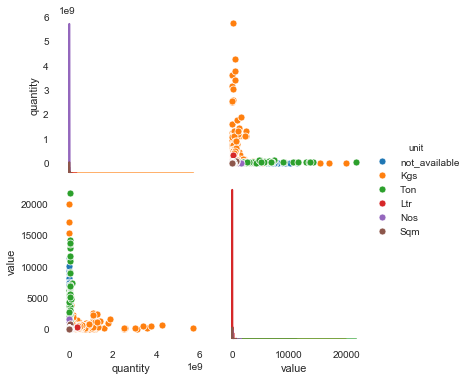

In [24]:
#Univariate analysis with pairplot
sns.pairplot(data,hue='unit')

## Graphical Data Analysis

<blockquote>Univariate Analysis of Numerical Features

Name of Feature : quantity
Skewness of Feature : 58.191256081337286


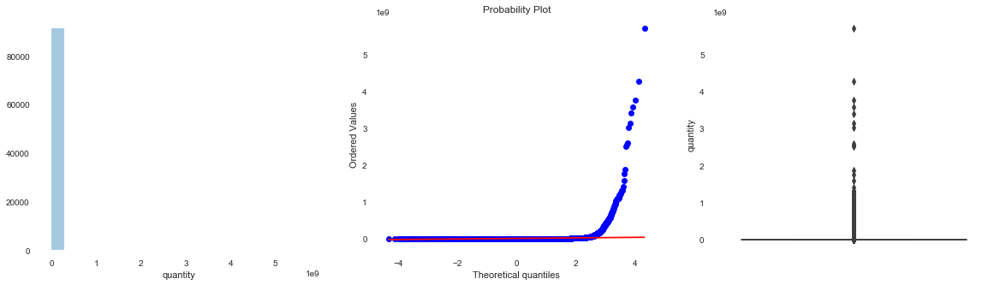

Name of Feature : value
Skewness of Feature : 38.73522778569806


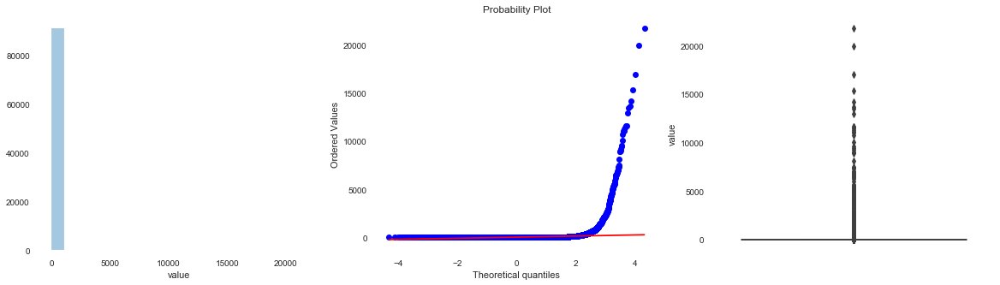

In [25]:
#Univariate Anaysis

#Defining the function which van do univariate anlysis on numerical features and returns histogram,box plot and ,qq plot with skewness
def univariate_analysis_numerical_features(data):
    for col in data:
        print('Name of Feature :',col)
    
        print('Skewness of Feature :',numerical_data[col].skew())
    
        plt.figure(figsize=(20,5))
    
        plt.subplot(1,3,1)
        sns.distplot(data[col],bins=20,kde=False)
    
        plt.subplot(1,3,2)
        stats.probplot(data[col],dist='norm',plot=plt)
    
        plt.subplot(1,3,3)
        sns.boxplot(y=data[col])
        plt.show()

#calling the function
univariate_analysis_numerical_features(numerical_data)

- From the above univariate analysis of numerical features, the distribution of numerical data with the help of histogram,qq plot and box plot is understood.
- Skewness can help us to understand the normality of the data
- From the statistical and grphical tests of numerical data we can conclude the the distribution of the numerical fetures is not normal

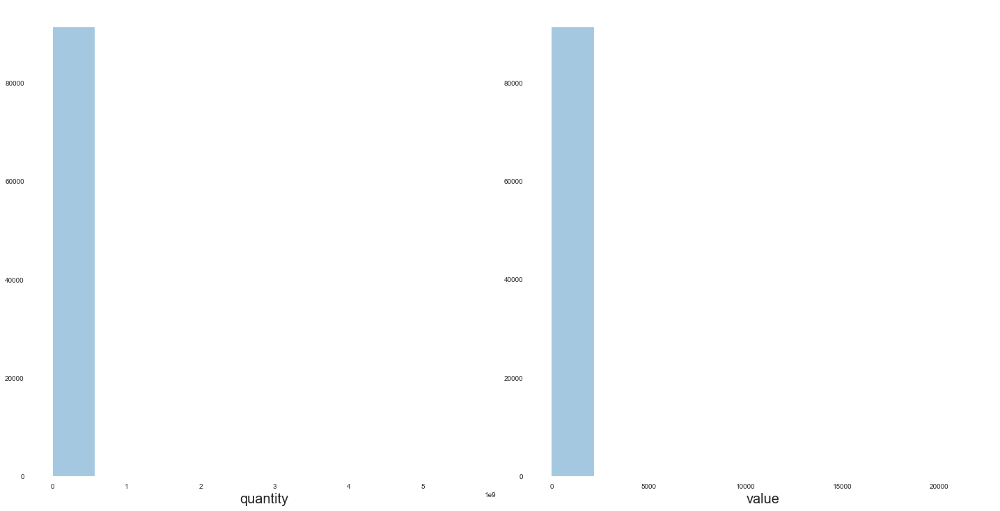

In [26]:
#Univariate Analysis 
#Univariate analysis for the numerical column
#Checking the distribution of numerical columns with the help of histogram

def univariate_analysis_histogram(data):
    plt.figure(figsize=(30,30), facecolor='white')
    plotnumber = 1

    for column in data:
        if plotnumber<=30 :
            ax = plt.subplot(3,3,plotnumber)
            sns.distplot(numerical_data[column],bins=10,kde=False)
            plt.xlabel(column,fontsize=20)
        #plt.ylabel('Salary',fontsize=20)
        plotnumber+=1
    plt.tight_layout()
    
#calling the function
univariate_analysis_histogram(numerical_data)

<blockquote>Bivariate Analysis of Numerical Features

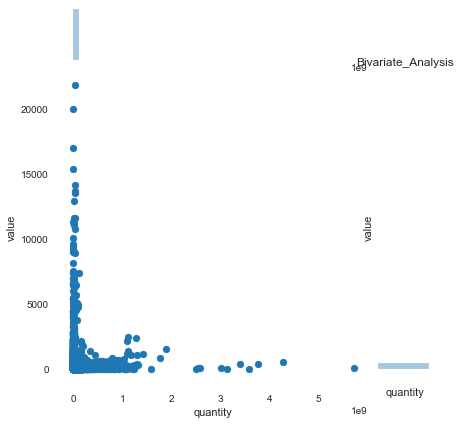

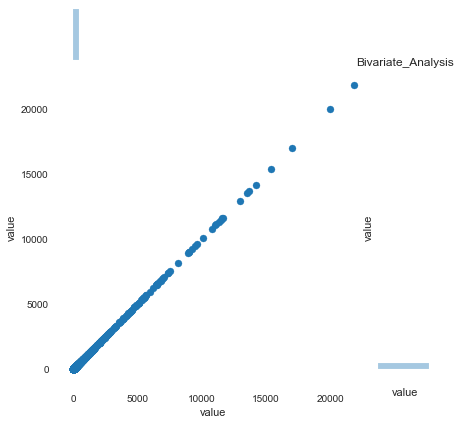

In [27]:
#Bivariate Analysis for Numerical Columns
#Bivariate analysis
#Bivariate Analysis with scatter plot between quantity and value

def bivariate_analysis_numrical_to_numerical(data,numerical_feature_y):
    for feature in data:
        ax=sns.jointplot(x=feature,y=numerical_feature_y,data=data,kind='scatter')
        plt.xlabel(feature)
        plt.ylabel(numerical_feature_y)
        plt.title('Bivariate_Analysis')
        

#calling the functiom
bivariate_analysis_numrical_to_numerical(numerical_data,'value')

<blockquote>Univariate Analysis of Categorical Features

Percentage of datapoints present in class : 

 not_available    53.062117
Kgs              25.497594
Ton              17.775591
Nos               1.957568
Sqm               1.139545
Ltr               0.567585
Name: unit, dtype: float64


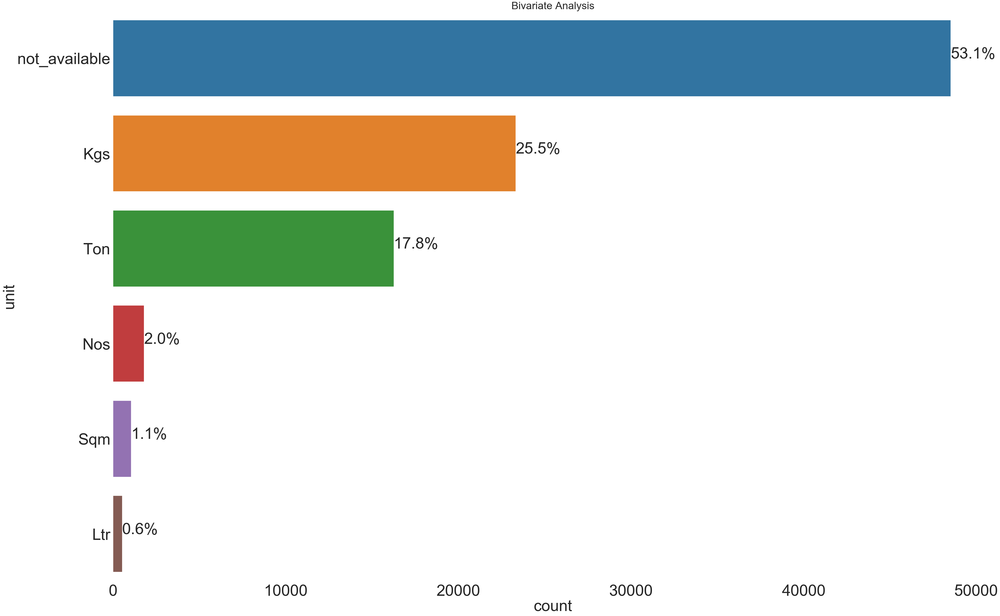

In [28]:
#Univariate analysis for categorical features
#univarite analysis with countplot with percentage distribution of datapoints
def univariate_analysis_categorical_countplot(data,label):
    plt.figure(figsize=(60,40))
    ax=sns.countplot(y=data[label],data=data,order = data[label].value_counts().index)
    ax.axes.set_title('Bivariate Analysis',fontsize=40)
    ax.set_ylabel(label,fontsize=60)
    ax.set_xlabel('count',fontsize=60)
    ax.tick_params(labelsize=60)
    
    total = len(data[label])
    for p in ax.patches:
        percentage = '{:.1f}%'.format(100 * p.get_width()/total)
        x = p.get_x() + p.get_width() + 0.02
        y = p.get_y() + p.get_height()/2
        ax.annotate(percentage, (x, y),fontsize=60)
    
    print('Percentage of datapoints present in class : \n\n',(data[label].value_counts()/data[label].count())*100)
        
    plt.show()


#univariate analysis of cateforical features
univariate_analysis_categorical_countplot(data,'unit')

In [29]:
#Univariate analysis for categorical features
#univarite analysis with countplot with percentage distribution of datapoints
def univariate_analysis_categorical_countplot(data,label):
    plt.figure(figsize=(90,300))
    ax=sns.countplot(y=data[label],data=data,order = data[label].value_counts().index)
    ax.axes.set_title('Bivariate Analysis',fontsize=40)
    ax.set_ylabel(label,fontsize=60)
    ax.set_xlabel('count',fontsize=60)
    ax.tick_params(labelsize=62)
    
    total = len(data[label])
    for p in ax.patches:
        percentage = '{:.1f}%'.format(100 * p.get_width()/total)
        x = p.get_x() + p.get_width() + 0.02
        y = p.get_y() + p.get_height()/2
        ax.annotate(percentage, (x, y),fontsize=60)

    plt.show()


#univariate analysis of cateforical features
univariate_analysis_categorical_countplot(data,'country_name')

In [30]:
#Univariate analysis for categorical features
#univarite analysis with countplot with percentage distribution of datapoints
def univariate_analysis_categorical_countplot(data,label):
    plt.figure(figsize=(90,250))
    ax=sns.countplot(y=data[label],data=data,order = data[label].value_counts().index)
    ax.axes.set_title('Bivariate Analysis',fontsize=40)
    ax.set_ylabel(label,fontsize=60)
    ax.set_xlabel('count',fontsize=60)
    ax.tick_params(labelsize=70)
    
    total = len(data[label])
    for p in ax.patches:
        percentage = '{:.1f}%'.format(100 * p.get_width()/total)
        x = p.get_x() + p.get_width() + 0.02
        y = p.get_y() + p.get_height()/2
        ax.annotate(percentage, (x, y),fontsize=65)

    plt.show()


#univariate analysis of cateforical features
univariate_analysis_categorical_countplot(data,'pc_description')

<blockquote>Bivariate Analysis of Categorical Features

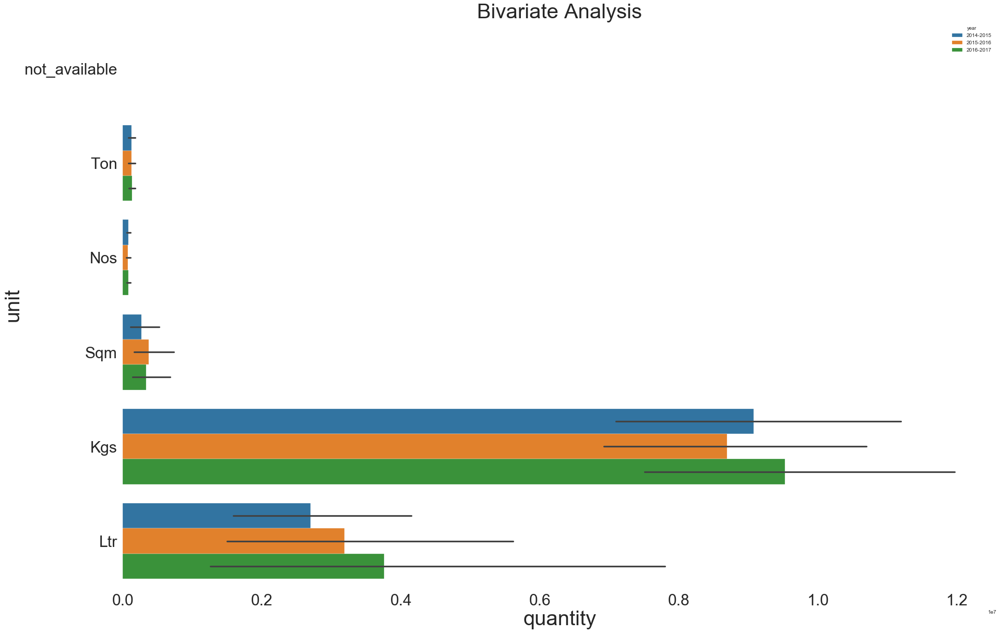

In [31]:
#Bivariate analysis numerical to categorical feature analysis

#Defining the function which takes input as a numerical and categorical feature with data
#returns the bivariate barplot
def bivarate_analysis_barplot(data,categorical_feature,numerical_feature,hue):
    plt.figure(figsize=(30,20))
    result = data.groupby([categorical_feature])[numerical_feature].aggregate(np.median).reset_index().sort_values(numerical_feature)
    b=sns.barplot(y=data[categorical_feature],x=data[numerical_feature],data=data,hue=hue,
              order=result[categorical_feature])
    b.axes.set_title('Bivariate Analysis',fontsize=40)
    b.set_xlabel(numerical_feature,fontsize=40)
    b.set_ylabel(categorical_feature,fontsize=40)
    b.tick_params(labelsize=30)
    plt.show()
    
    
#calling the function
bivarate_analysis_barplot(data,'unit','quantity','year')

In [32]:
#Bivariate analysis numerical to categorical feature analysis

#Defining the function which takes input as a numerical and categorical feature with data
#returns the bivariate barplot
def bivarate_analysis_barplot(data,categorical_feature,numerical_feature,hue):
    plt.figure(figsize=(90,400))
    result = data.groupby([categorical_feature])[numerical_feature].aggregate(np.median).reset_index().sort_values(numerical_feature)
    b=sns.barplot(y=data[categorical_feature],x=data[numerical_feature],data=data,hue=hue,
              order=result[categorical_feature])
    b.axes.set_title('Bivariate Analysis',fontsize=40)
    b.set_xlabel(numerical_feature,fontsize=40)
    b.set_ylabel(categorical_feature,fontsize=40)
    b.tick_params(labelsize=90)
    plt.show()
    
    
#calling the function
bivarate_analysis_barplot(data,'pc_description','value',None)

In [36]:
#Bivariate analysis numerical to categorical feature analysis

#Defining the function which takes input as a numerical and categorical feature with data
#returns the bivariate barplot
def bivarate_analysis_barplot(data,categorical_feature,numerical_feature,hue):
    plt.figure(figsize=(100,400))
    result = data.groupby([categorical_feature])[numerical_feature].aggregate(np.median).reset_index().sort_values(numerical_feature)
    b=sns.barplot(y=data[categorical_feature],x=data[numerical_feature],data=data,hue=hue,
              order=result[categorical_feature])
    b.axes.set_title('Bivariate Analysis',fontsize=40)
    b.set_xlabel(numerical_feature,fontsize=40)
    b.set_ylabel(categorical_feature,fontsize=40)
    b.tick_params(labelsize=100)
    plt.show()
    
    
#calling the function
bivarate_analysis_barplot(data,'country_name','quantity',None)

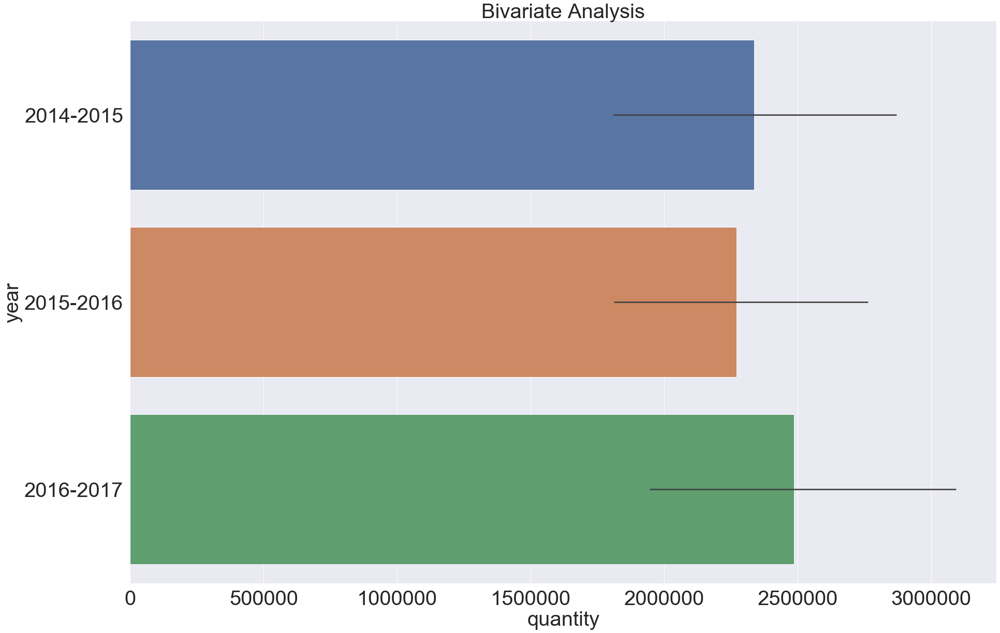

In [40]:
#Bivariate analysis numerical to categorical feature analysis

#Defining the function which takes input as a numerical and categorical feature with data
#returns the bivariate barplot
def bivarate_analysis_barplot(data,categorical_feature,numerical_feature,hue):
    plt.figure(figsize=(30,20))
    result = data.groupby([categorical_feature])[numerical_feature].aggregate(np.median).reset_index().sort_values(numerical_feature)
    b=sns.barplot(y=data[categorical_feature],x=data[numerical_feature],data=data,hue=hue,
              order=result[categorical_feature])
    b.axes.set_title('Bivariate Analysis',fontsize=40)
    b.set_xlabel(numerical_feature,fontsize=40)
    b.set_ylabel(categorical_feature,fontsize=40)
    b.tick_params(labelsize=40)
    plt.show()
    
    
#calling the function
bivarate_analysis_barplot(data,'year','quantity',None)

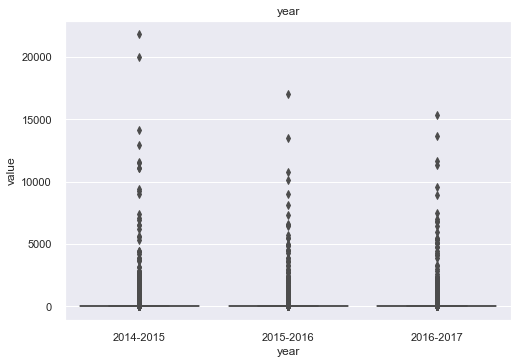

In [33]:
#Function for the bivariate analysis of features with the help of boxplot

def bivariate_analysis_boxplot(data,categorical_feature,numerical_feature):
    sns.set(context='notebook', style='darkgrid', 
            palette='deep', font='sans-serif', font_scale=1, color_codes=True, rc=None)

    ax=sns.boxplot(y=data[numerical_feature],x=data[categorical_feature],data=data)
    
    plt.ylabel(numerical_feature)
    plt.xlabel(categorical_feature)
    plt.title(categorical_feature)  
    plt.show()
    
#calling the function
bivariate_analysis_boxplot(data,'year','value')

<blockquote>Correlation Plot

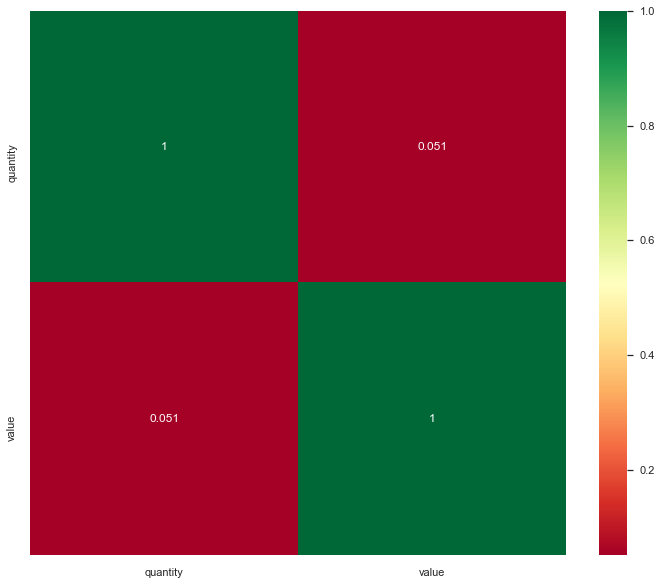

In [34]:
plt.figure(figsize=(12,10))  # on this line I just set the size of figure to 12 by 10.
p=sns.heatmap(data.corr(), annot=True,cmap ='RdYlGn')  # seaborn has very simple solution for heatmap

##  Conclusion 

- With the help of notebook I learnt how exploratory data analysis can be carried out using Pandas plotting.
- Also I have seen making use of packages like __matplotlib and seaborn__ to develop better insights about the data.<br/>
- I have also seen how __preproceesing__ helps in dealing with _missing_ values and irregualities present in the data. I also learnt how to _create new features_ which will in turn help us to better predict the survival. 
- I also make use of __pandas profiling__ feature to generate an html report containing all the information of the various features present in the dataset.
- I have seen the impact of columns like country, year and quantity on the value increase/decrease rate__.
- The most important inference drawn from all this analysis is, I get to know what are the __features on which price is highly positively and negatively coorelated with.__ 
- This analysis will help me to choose which __machine learning model__ we can apply to predict price of test dataset in later terms and projects. 